TALLER # 1 CIENCIA DE DATOS

2025-20

UNIVERSIDAD DE LOS ANDES


DIEGO FELIPE CARVAJAL LOMBO - 201911910

JESÚS MANUEL OSPINO - 201915195

# 0. Importación de librerías

In [ ]:
!pip install ydata-profiling

In [ ]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
import pandas_profiling


# 1. Carga y exploración de datos

In [ ]:
#Carga de datos "hotel_booking_modified.csv"
data= pd.read_csv("/content/hotel_bookings_modified.csv")

/tmp/ipython-input-3409908224.py:2: DtypeWarning: Columns (24) have mixed types. Specify dtype option on import or set low_memory=False.
  data= pd.read_csv("/content/hotel_bookings_modified.csv")


In [ ]:
data.describe()

,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,agent,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,kids
count,58895.000000,58895.000000,58307.000000,58895.000000,58895.000000,58895.000000,58895.000000,58895.000000,58891.000000,58895.000000,58895.000000,58895.000000,58895.000000,58895.000000,49763.000000,58894.000000,58894.000000,58306.000000,58894.000000,201.000000
mean,0.411393,100.050904,2205.522939,27.837389,15.766432,1.058154,2.847576,1.969148,0.112937,0.136599,0.030189,0.069191,0.099618,0.243009,146.983080,3.525979,96.250426,0.096697,0.512225,34.417910
std,0.492090,101.162420,1837.392466,13.346053,8.783036,1.093032,2.235486,2.943454,0.419710,3.115889,0.171109,1.102138,0.829166,0.695205,120.114987,21.841676,58.555599,0.300382,0.768378,38.571032
min,0.000000,0.000000,2015.000000,1.000000,1.000000,0.000000,0.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,-6.380000,0.000000,0.000000,-1.000000
25%,0.000000,17.000000,2016.000000,17.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,0.000000,60.000000,0.000000,0.000000,-1.000000
50%,0.000000,69.000000,2016.000000,29.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,196.000000,0.000000,84.000000,0.000000,0.000000,-1.000000
75%,1.000000,157.000000,2016.000000,38.000000,23.000000,2.000000,4.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,240.000000,0.000000,120.000000,0.000000,1.000000,65.000000
max,1.000000,737.000000,20016.000000,53.000000,31.000000,19.000000,50.000000,100.000000,10.000000,100.000000,1.000000,26.000000,30.000000,20.000000,535.000000,391.000000,5400.000000,8.000000,5.000000,100.000000


In [ ]:
#Revisión tipos de variables y si corresponden con lo documentado en el diccionario de
data.dtypes

,0
hotel,object
is_canceled,int64
lead_time,int64
arrival_date_year,float64
arrival_date_month,object
arrival_date_week_number,int64
arrival_date_day_of_month,int64
stays_in_weekend_nights,int64
stays_in_week_nights,int64
adults,int64


Vemos que la columna reservation_status_date, a pesar de ser una fecha, se lee como tipo object, por lo que antes de hacer el pandas profiling, vamos a convertirla a tipo date. El resto de columnas parece coincidir el tipo de dato con lo que representa.

In [ ]:
data["reservation_status_date"].unique()

array(['2015-07-01', '2015-07-02', '2015-07-03', '2015-05-06',
       '2015-04-22', '2015-06-23', '2015-07-05', '2015-07-06',
       '2015-07-07', '2015-07-08', '2015-05-11', '2015-07-15',
       '2015-07-16', '2015-05-29', '2015-05-19', '2015-06-19',
       '2015-05-23', '2015-05-18', '2015-07-09', '2015-06-02',
       '2015-07-13', '2015-07-04', '2015-06-29', '2015-06-16',
       '2015-06-18', '2015-06-12', '2015-06-09', '2015-05-26',
       '2015-07-11', '2015-07-12', '2015-07-17', '2015-04-15',
       '2015-05-13', '2015-07-10', '2015-05-20', '2015-05-12',
       '2015-07-14', '2015-06-17', '2015-05-01', '2015-03-30',
       '2015-07-19', '2015-06-03', '2015-06-26', '2015-05-14',
       '2015-07-20', '2015-05-07', '2015-05-28', '2015-04-13',
       '2015-03-25', '2015-07-21', '2015-06-27', '2015-07-18',
       '2015-07-23', '2015-06-08', '2015-06-22', '2015-06-24',
       '2015-03-05', '2015-06-01', '2015-04-24', '2015-07-22',
       '2015-05-27', '2015-04-06', '2015-04-11', '2015-

In [ ]:
data["reservation_status_date"] = pd.to_datetime(data["reservation_status_date"])

In [ ]:
data["reservation_status_date"].sample(5)

,reservation_status_date
25318,2016-06-22
26927,2016-08-15
29355,2016-10-27
44172,2015-10-04
44797,2015-08-18


In [ ]:
report = pandas_profiling.ProfileReport(data)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 33/33 [00:06<00:00,  4.88it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## 1.1. Limpieza de datos

Previo a la selección de datos, vamos a hacer una limpieza general de estos, para que no tengan inconsistencias o que tenga coherencia con las reglas de negocio. Por ejemplo, que la cantidad de personas no sea negativo.

In [ ]:
data.shape

(58895, 33)

Tenemos 58.895 reservas y 33 columnas

In [ ]:
data["reservation_status_date"].isnull().sample(5)

,reservation_status_date
812,False
9414,False
45040,False
43230,False
14231,False


In [ ]:
fecha_max=data["reservation_status_date"].max()
fecha_min= data["reservation_status_date"].min()
print(f'Los datos se encuentran en un intervarlo entre {fecha_min} y {fecha_max},\n contemplan {fecha_max-fecha_min} días.                                                                          ')

Los datos se encuentran en un intervarlo entre 2014-11-18 00:00:00 y 2017-09-14 00:00:00,
 contemplan 1031 days 00:00:00 días.                                                                          


In [ ]:
data.head(5)

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,kids
0,Resort Hotel,0,342,2015.0,July,27,1,0,0,2,...,NaN,NaN,0.0,Transient,0.0,0.0,0.0,Check-Out,2015-07-01,NaN
1,Resort Hotel,0,737,2015.0,July,27,1,0,0,2,...,NaN,NaN,0.0,Transient,0.0,0.0,0.0,Check-Out,2015-07-01,NaN
2,Resort Hotel,0,7,2015.0,July,27,1,0,1,1,...,NaN,NaN,0.0,Transient,75.0,0.0,0.0,Check-Out,2015-07-02,NaN
3,Resort Hotel,0,13,2015.0,July,27,1,0,1,1,...,304.0,NaN,0.0,Transient,75.0,0.0,0.0,Check-Out,2015-07-02,NaN
4,Resort Hotel,0,14,2015.0,July,27,1,0,2,2,...,240.0,NaN,0.0,Transient,98.0,0.0,1.0,Check-Out,2015-07-03,NaN


In [ ]:
data.sample(5)

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,kids
28475,Resort Hotel,0,342,2016.0,September,40,29,2,4,1,...,201.0,NaN,0.0,Transient-Party,36.0,0.0,0.0,Check-Out,2016-10-05,NaN
11847,Resort Hotel,1,160,2017.0,June,22,1,2,8,2,...,40.0,NaN,0.0,Contract,68.4,0.0,0.0,Canceled,2017-03-31,NaN
39894,Resort Hotel,0,5,2017.0,August,35,30,0,1,2,...,240.0,NaN,0.0,Transient,171.0,0.0,1.0,Check-Out,2017-08-31,NaN
9253,Resort Hotel,1,211,2016.0,November,45,5,2,1,2,...,11.0,NaN,0.0,Transient,30.0,0.0,0.0,Canceled,2016-07-18,NaN
14999,Resort Hotel,1,244,2015.0,September,36,3,0,3,2,...,NaN,NaN,0.0,Transient,36.0,0.0,0.0,Canceled,2015-04-29,NaN


In [ ]:
data.tail(5)

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,kids
58890,Resort Hotel,0,3,2016.0,April,16,11,1,0,1,...,240.0,NaN,0.0,Transient-Party,56.00,0.0,1.0,Check-Out,2016-04-12,NaN
58891,Resort Hotel,1,158,2016.0,May,20,8,2,2,2,...,250.0,NaN,0.0,Transient,83.05,0.0,1.0,Canceled,2016-01-21,NaN
58892,City Hotel,1,18,2016.0,August,32,6,2,2,2,...,9.0,NaN,0.0,Transient,151.00,0.0,2.0,Canceled,2016-07-28,NaN
58893,Resort Hotel,1,383,2016.0,October,41,6,1,3,2,...,315.0,NaN,0.0,Transient-Party,48.00,0.0,0.0,Canceled,2016-03-04,NaN
58894,City Hotel,1,185,2016.0,July,28,5,0,4,2,...,9.0,NaN,0.0,Transient,90.95,0.0,1.0,Canceled,2016-05-31,NaN


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58895 entries, 0 to 58894
Data columns (total 33 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   hotel                           58895 non-null  object        
 1   is_canceled                     58895 non-null  int64         
 2   lead_time                       58895 non-null  int64         
 3   arrival_date_year               58307 non-null  float64       
 4   arrival_date_month              58895 non-null  object        
 5   arrival_date_week_number        58895 non-null  int64         
 6   arrival_date_day_of_month       58895 non-null  int64         
 7   stays_in_weekend_nights         58895 non-null  int64         
 8   stays_in_week_nights            58895 non-null  int64         
 9   adults                          58895 non-null  int64         
 10  children                        58891 non-null  float64       
 11  ba

Después de comparar la cantidad de datos en el dataset frente a la cantidad de valores no nulos dentro del dataset, encontramos que las variables company, agent y kids son aquellas con mayor cantidad de valores nulos. Es por tal razón que se iniciará la revisión y limpieza pertinente del dataset por estas variables.

Company tiene tantos datos nulos que directamente no se va a selccionar y se va a eliminar la columna

In [ ]:
data["agent"].unique()

array([ nan, 304., 240., 303.,  15., 241.,   8., 250., 115.,   5., 175.,
       134., 156., 243., 242.,   3., 105.,  40., 147., 306., 184.,  96.,
         2., 127.,  95., 146.,   9., 177.,   6., 143., 244., 149., 167.,
       300., 171., 305.,  67., 196., 152., 142., 261., 104.,  36.,  26.,
        29., 258., 110.,  71., 181.,  88., 251., 275.,  69., 248., 208.,
       256., 314., 126., 281., 273., 253., 185., 330., 334., 328., 326.,
       321., 324., 313.,  38., 155.,  68., 335., 308., 332.,  94., 348.,
       310., 339., 375.,  66., 327., 387., 298.,  91., 245., 385., 257.,
       393., 168., 405., 249., 315.,  75., 128., 307.,  11., 436.,   1.,
       201., 183., 223., 368., 336., 291., 464., 411., 481.,  10., 154.,
       468., 410., 390., 440., 495., 492., 493., 434.,  57., 531., 420.,
       483., 526., 472., 429.,  16., 446.,  34.,  78., 139., 252., 270.,
        47., 114., 301., 193., 182., 135., 350., 195., 352., 355., 159.,
       363., 384., 360., 331., 367.,  64., 406., 16

Vemos que agent representa el ID del agente, como no tenemos información del mismo. Y además, tiene una gran cantidad de nulos se va a eliminar y no se va a seleccionar

In [ ]:
data["kids"].unique()

array([ nan,  98.,  -1.,  95.,  82.,  84.,  58.,  92.,  87.,  53.,  65.,
        96.,  97.,  60.,  83.,  78.,  86.,  61.,  62.,  59.,  57.,  85.,
        55.,  70.,  89.,  67.,  80.,  63.,  74.,  77.,  73.,  69.,  88.,
        52.,  76.,  93., 100.,  64.,  72.,  54.,  56.,  81.])

De la misma manera, la variable Kids no tiene relación con la realidad dado que los datos se encuentran encima de 50. Además, no está en el diccionario. Por lo que se elimina

## 1.2 Selección de variables

Se decide seleccionar las variables:

- Suma total personas: Se va a sumar las variables adults, children y babies para saber el número total de personas por reserva, para poder juntar las 3 variables y analizarlas.

- deposit_type: Consideramos importante revisar el tipo de depósito, ya que esto puede influír en si las personas efectivamente asisten al hotel o cancelan.

- adr: Al definirse como Average Daily Rate. Que es la suma total del precio las transacciones realizadas por el grupo de personas sobre la cantidad de días, podemos hacer un análisis de quienes son los que más están gastando en los hoteles.

- is_canceled: Nos ayuda a revisar si la reserva fue cancelada o no

- lead_time: Con esto podemos ver si el tiempo de anticipación de la reserva afecta a la cancelación de esta o cantidad de dinero gastado de las personas

- arrival_date_month: Esta variable nos permitirá tener nociones temporales y ahondar en la existencia de patrones dado un mes o conjunto de ellos.


### 1.2.1 Suma Total Personas

In [ ]:
data["adults"].unique()

array([  2,   1,   3,  -1,   4,  40,  26,  50,  53,  27,  72,  55,   0,
        20,   6,   5,  51,  10,  54,  78,  76,  68,  57,  69,  96, 100,
        83,  84,  95,  66,  64,  73,  56,  80,  59,  92,  89,  86,  63,
        91,  61,  52,  79,  58,  93,  65,  98,  67,  62,  87,  85,  77,
        60,  75])

<Axes: >

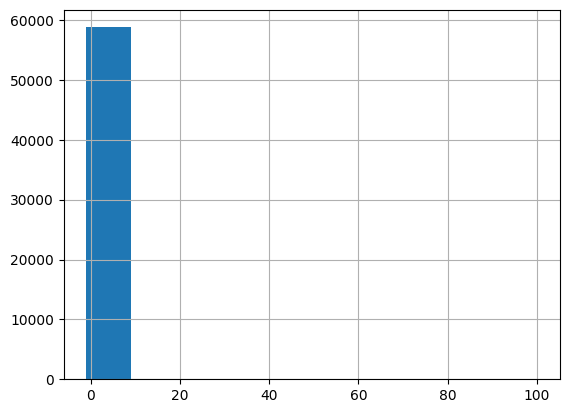

In [ ]:
data["adults"].hist()

In [ ]:
data["adults"].describe()

,adults
count,58895.000000
mean,1.969148
std,2.943454
min,-1.000000
25%,2.000000
50%,2.000000
75%,2.000000
max,100.000000


In [ ]:
data["adults"] = data["adults"].astype(int)

In [ ]:
data['adults'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 58895 entries, 0 to 58894
Series name: adults
Non-Null Count  Dtype
--------------  -----
58895 non-null  int64
dtypes: int64(1)
memory usage: 460.2 KB


In [ ]:
data['adults'].sample(5)

,adults
14813,2
32227,1
51504,2
25919,2
27401,2


In [ ]:
conteo = data["adults"].value_counts()
print(conteo)

adults
 2      45712
 1      10610
 3       2225
 0        104
-1         99
 4         34
 66         6
 26         5
 65         5
 53         4
 69         4
 59         4
 54         4
 91         4
 84         3
 95         3
 100        3
 72         3
 76         3
 50         3
 79         3
 20         2
 60         2
 86         2
 92         2
 68         2
 51         2
 5          2
 55         2
 78         2
 27         2
 83         2
 56         2
 73         2
 80         2
 64         2
 96         2
 57         2
 67         2
 62         2
 98         2
 52         2
 6          1
 10         1
 40         1
 89         1
 93         1
 58         1
 63         1
 61         1
 87         1
 85         1
 77         1
 75         1
Name: count, dtype: int64


De lo anterior, podemos ver que hay valores de 0 y -1. Esto no sigue las reglas de negocio ya que no tiene sentido valores negativos, y la plataforma solo permite hacer reservaciones a personas mayores de edad. Gracias a que la cantidad de registros con estos valores son pocas, vamos a eliminarlos

In [ ]:
df = data.copy()
df.shape

(58895, 33)

In [ ]:
df = df[~data["adults"].isin([0, -1])]
conteo = df["adults"].value_counts()
print(conteo)

adults
2      45712
1      10610
3       2225
4         34
66         6
26         5
65         5
53         4
69         4
59         4
54         4
91         4
84         3
95         3
100        3
50         3
76         3
72         3
79         3
55         2
60         2
86         2
92         2
68         2
51         2
5          2
20         2
78         2
27         2
83         2
56         2
73         2
80         2
64         2
96         2
57         2
67         2
62         2
98         2
52         2
6          1
10         1
40         1
89         1
93         1
58         1
63         1
61         1
87         1
85         1
77         1
75         1
Name: count, dtype: int64


In [ ]:
df.shape

(58692, 33)

Ahora validamos children

In [ ]:
conteo = df["children"].value_counts()
print(conteo)

children
0.0     54292
1.0      2331
2.0      2042
3.0        22
10.0        1
Name: count, dtype: int64


In [ ]:
df["children"].info()

<class 'pandas.core.series.Series'>
Index: 58692 entries, 0 to 58894
Series name: children
Non-Null Count  Dtype  
--------------  -----  
58688 non-null  float64
dtypes: float64(1)
memory usage: 917.1 KB


En la columna Children, vemos que hay 4 registros que son nulos, por lo que vamos a rellenarlos con 0.

In [ ]:
df["children"] = df["children"].fillna(0)
df["children"].info()

<class 'pandas.core.series.Series'>
Index: 58692 entries, 0 to 58894
Series name: children
Non-Null Count  Dtype  
--------------  -----  
58692 non-null  float64
dtypes: float64(1)
memory usage: 917.1 KB


In [ ]:
conteo = df["children"].value_counts()
print(conteo)

children
0.0     54296
1.0      2331
2.0      2042
3.0        22
10.0        1
Name: count, dtype: int64


In [ ]:
df["children"] = df["children"].astype(int)

In [ ]:
conteo = df["children"].value_counts()
print(conteo)

children
0     54296
1      2331
2      2042
3        22
10        1
Name: count, dtype: int64


Ahora vamos a validar babies

In [ ]:
conteo = df["babies"].value_counts()
print(conteo)

babies
 0      57892
 1        597
-1         90
 2          9
 51         6
 57         5
 73         5
 77         5
 94         4
 97         4
 81         4
 56         4
 65         4
 61         3
 67         3
 70         3
 92         3
 66         3
 93         3
 59         3
 72         2
 82         2
 58         2
 75         2
 55         2
 52         2
 69         2
 53         2
 96         2
 71         2
 98         2
 100        2
 63         2
 78         2
 99         2
 54         1
 89         1
 62         1
 95         1
 74         1
 60         1
 84         1
 10         1
 91         1
 50         1
 83         1
 88         1
Name: count, dtype: int64


In [ ]:
df[df["babies"] >= 10][["adults", "children", "babies"]].sort_values(by = "adults", ascending = False)

,adults,children,babies
14275,3,0,96
40638,3,0,56
58206,3,0,97
55835,3,0,88
41995,3,0,70
...,...,...,...
43980,1,0,77
49930,1,0,55
52762,1,0,63
53623,1,0,50


Al validar las reservas que tenían más de 9 bebés, podemos ver que la cantidad de adultos máxima es de únicamente 3, lo cual no tiene sentido en el negocio. Por lo que se procede a eliminar. De la misma manera, vamos a eliminar los valores negativos

In [ ]:
df = df[(df["babies"] >= 0) & (df["babies"] < 10)]
conteo = df["babies"].value_counts()
print(conteo)

babies
0    57892
1      597
2        9
Name: count, dtype: int64


In [ ]:
df["babies"] = df["babies"].fillna(0)

In [ ]:
df["babies"].info()

<class 'pandas.core.series.Series'>
Index: 58498 entries, 0 to 58894
Series name: babies
Non-Null Count  Dtype
--------------  -----
58498 non-null  int64
dtypes: int64(1)
memory usage: 914.0 KB


In [ ]:
df["sum_total_personas"] = df["adults"] + df["children"] + df["babies"]
df["sum_total_personas"].describe()

,sum_total_personas
count,58498.000000
mean,2.099012
std,2.983222
min,1.000000
25%,2.000000
50%,2.000000
75%,2.000000
max,100.000000


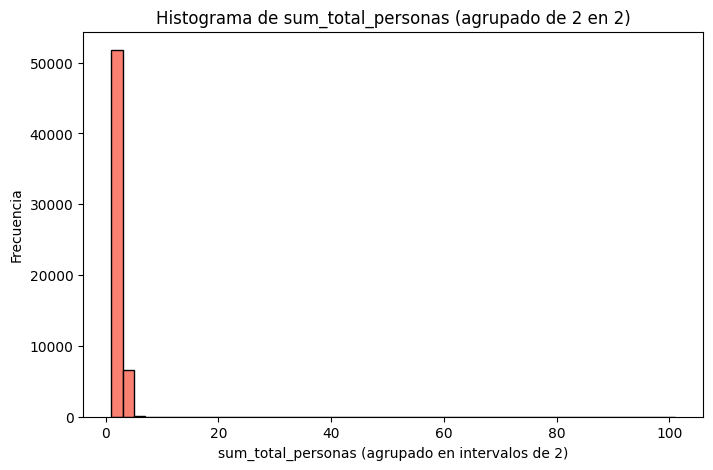

In [ ]:
plt.figure(figsize=(8, 5))
plt.hist(df["sum_total_personas"], bins=range(df["sum_total_personas"].min(), df["sum_total_personas"].max() + 2, 2), color="salmon", edgecolor="black")
plt.title("Histograma de sum_total_personas (agrupado de 2 en 2)")
plt.xlabel("sum_total_personas (agrupado en intervalos de 2)")
plt.ylabel("Frecuencia")
plt.show()


Al realizar el análisis univariable de la cantidad de personas por reserva, podemos ver que la gran mayoría (>80%) tiene únicamente 2 personas. Por lo que va a ser muy difícil obtener insights de un valor tan constante. Por lo que decidimos no usar esta columna calculada.

### 1.2.2 Deposit type

In [ ]:
df["deposit_type"].unique()

array(['No Deposit', 'Refundable', 'Non Refund', 'No Refund'],
      dtype=object)

In [ ]:
conteo = df["deposit_type"].value_counts()
print(conteo)

deposit_type
No Deposit    51972
Non Refund     5428
No Refund       956
Refundable      142
Name: count, dtype: int64


Vemos que el valor "No refund" se repite menos y veces, y además no existe en el diccionario de datos. Por lo que, vamos a cambiarlo a "Non Refund"

In [ ]:
df["deposit_type"] = df["deposit_type"].replace("No Refund", "Non Refund")
conteo = df["deposit_type"].value_counts()
print(conteo)

deposit_type
No Deposit    51972
Non Refund     6384
Refundable      142
Name: count, dtype: int64


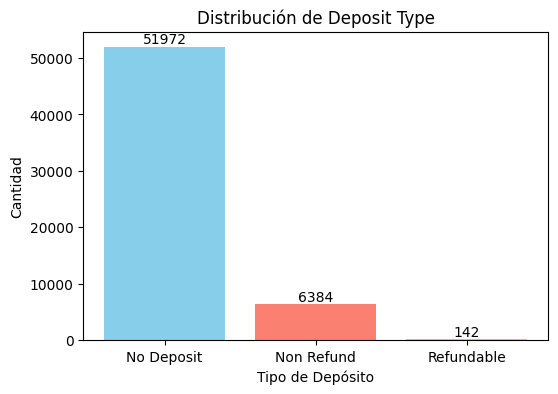

In [ ]:
counts = df["deposit_type"].value_counts()

plt.figure(figsize=(6, 4))
bars = plt.bar(counts.index, counts.values, color=["skyblue", "salmon", "lightgreen"])
plt.title("Distribución de Deposit Type")
plt.xlabel("Tipo de Depósito")
plt.ylabel("Cantidad")

# Agregar etiquetas de conteo arriba de cada barra
for bar in bars:
    plt.text(bar.get_x() + bar.get_width()/2, bar.get_height(),
             str(bar.get_height()), ha="center", va="bottom")

plt.show()

Podemos evidenciar que la gran mayoría de las reservas no tienen depósito, lo que podría influír en las reservas que se pueden cancelar.

### 1.2.3 ADR

In [ ]:
df["adr"].unique()

array([  0.  ,  75.  ,  98.  , ..., 147.3 , 129.51,    nan])

In [ ]:
conteo = df["adr"].value_counts()
print(conteo)

adr
62.00     1779
75.00     1070
48.00     1034
65.00      934
0.00       920
          ... 
235.94       1
171.72       1
133.60       1
146.92       1
229.46       1
Name: count, Length: 6745, dtype: int64


In [ ]:
df["adr"].describe()

,adr
count,58497.000000
mean,96.326639
std,58.569551
min,-6.380000
25%,60.000000
50%,84.000000
75%,120.000000
max,5400.000000


Al ser el promedio de gasto de las personas por reserva, no tiene sentido que este valor sea negativo. Por lo que se procede a eliminar los registros de este tipo

In [ ]:
df = df[df["adr"] > 0]
df["adr"].describe()

,adr
count,57576.000000
mean,97.867614
std,57.744620
min,0.260000
25%,61.000000
50%,85.000000
75%,121.000000
max,5400.000000


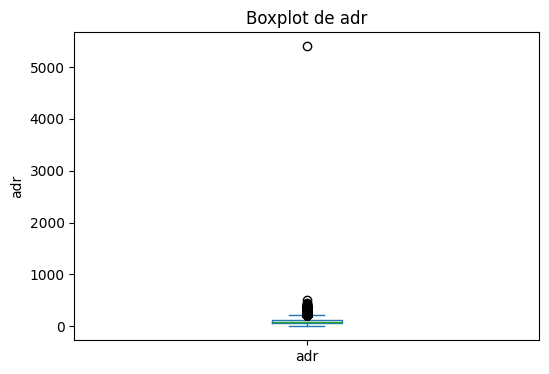

In [ ]:
plt.figure(figsize=(6, 4))
df["adr"].plot(kind="box")
plt.title("Boxplot de adr")
plt.ylabel("adr")
plt.show()

Del box plot anterior, podemos ver que hay un registro extremadamente atípico y aislado con un valor mayor 5000. Vamos a revisarlo puntualmente

In [ ]:
df[df["adr"] > 5000]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,kids,sum_total_personas
48515,City Hotel,1,35,20016.0,March,13,25,0,1,2,...,NaN,0.0,Transient,5400.0,0.0,0.0,Canceled,2016-02-19,NaN,2


Al revisar estríctamente la reserva con este valor atípico, podemos encontrarnos que fue cancelada, por lo que podemos dropearla dado su alto valor de la reserva. Además de ser un valor extremadamente atípico.

In [ ]:
df = df[df["adr"] < 5000]
df["adr"].describe()

,adr
count,57575.000000
mean,97.775524
std,53.349827
min,0.260000
25%,61.000000
50%,85.000000
75%,121.000000
max,508.000000


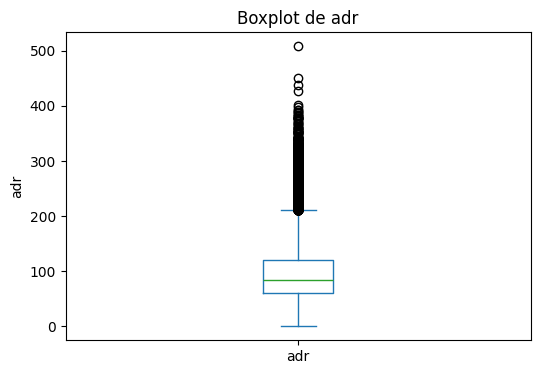

In [ ]:
plt.figure(figsize=(6, 4))
df["adr"].plot(kind="box")
plt.title("Boxplot de adr")
plt.ylabel("adr")
plt.show()

En el atenrior box plot, ya podemos encontrar mayor detalle al eliminar el registro cuyo adr era de 5400. Con esto, podemos ver que los valores normalmente están entre 0 y 200 dólares por noche gastados. Además, los valores atípicos pueden llegar hasta 500 dólares.

[]

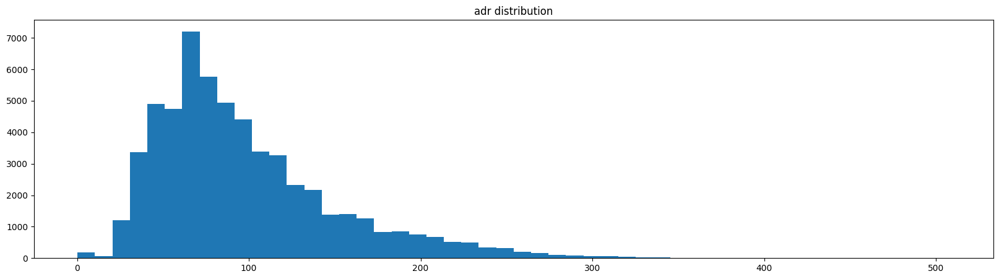

In [ ]:
plt.figure(figsize=(20, 5))
plt.hist(df[["adr"]], bins=50)
plt.title("adr distribution")
plt.plot()

Podemos ver que los datos de adr no siguen una distribución de campana. Es decir, los datos están mayormente entre 20 y 70, a pesar de que su media es 97.

### 1.2.4 is_canceled

In [ ]:
conteo = df["is_canceled"].value_counts()
print(conteo)

is_canceled
0    33642
1    23933
Name: count, dtype: int64


In [ ]:
conteo = df["is_canceled"].info()

<class 'pandas.core.series.Series'>
Index: 57575 entries, 2 to 58894
Series name: is_canceled
Non-Null Count  Dtype
--------------  -----
57575 non-null  int64
dtypes: int64(1)
memory usage: 899.6 KB


No tiene valores no acordes al negocio

<Axes: >

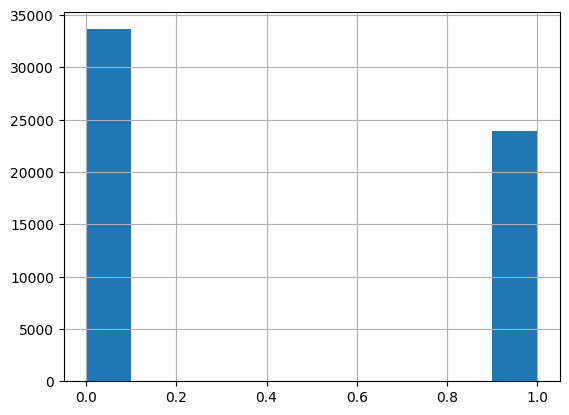

In [ ]:
df["is_canceled"].hist()

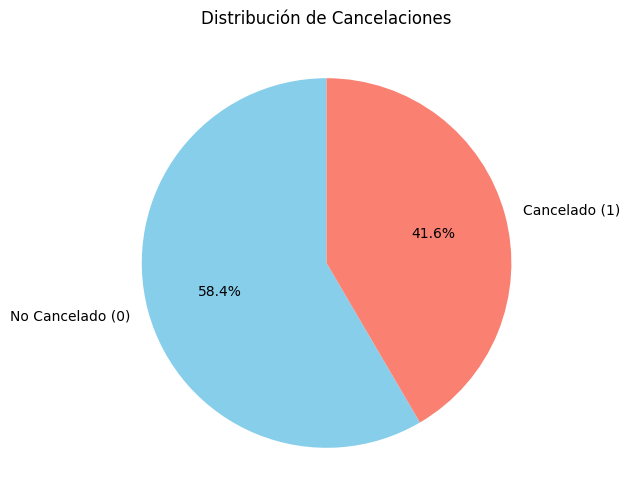

In [ ]:
counts = df["is_canceled"].value_counts()

labels = ["No Cancelado (0)", "Cancelado (1)"]
plt.figure(figsize=(6, 6))
plt.pie(counts, labels=labels, autopct="%1.1f%%", startangle=90, colors=["skyblue", "salmon"])
plt.title("Distribución de Cancelaciones")
plt.show()

En general, podemos ver que el porcentaje de cancelación de las reservas es superior al 40%. Por lo que, consideramos necesario encontrar alguna relación entre las cancelaciones y los otros atributos

### 1.2.5 lead_time

In [ ]:
conteo = df["lead_time"].value_counts()
print(conteo)

lead_time
0      3484
1      1830
2      1064
3       903
4       796
       ... 
370       1
434       1
424       1
400       1
374       1
Name: count, Length: 426, dtype: int64


In [ ]:
df["lead_time"].info()

<class 'pandas.core.series.Series'>
Index: 57575 entries, 2 to 58894
Series name: lead_time
Non-Null Count  Dtype
--------------  -----
57575 non-null  int64
dtypes: int64(1)
memory usage: 899.6 KB


No tiene valores no acordes al negocio

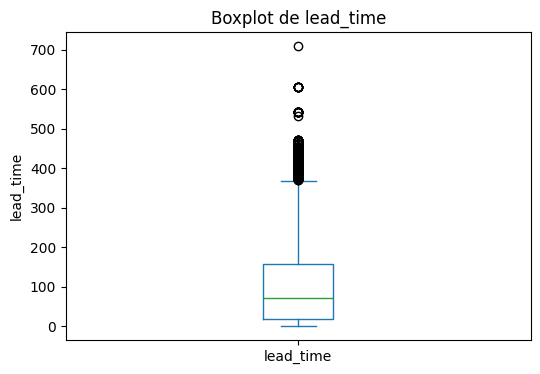

In [ ]:
plt.figure(figsize=(6, 4))
df["lead_time"].plot(kind="box")
plt.title("Boxplot de lead_time")
plt.ylabel("lead_time")
plt.show()

Del diagrama de caja, podemos visualizar que el lead time se encuentra normalmente distribuído entre 0 y 400, lo que es acorde al contexto del negocio, ya que consideramos que es normal que una persona realice una reserva con hasta un año de anticipación.

También podemos encontrar que existen outliers con un valor mayor a 400. Estos se dividen en 2 grupos; entre 400 y 500 días y mayores a 500 días.

[]

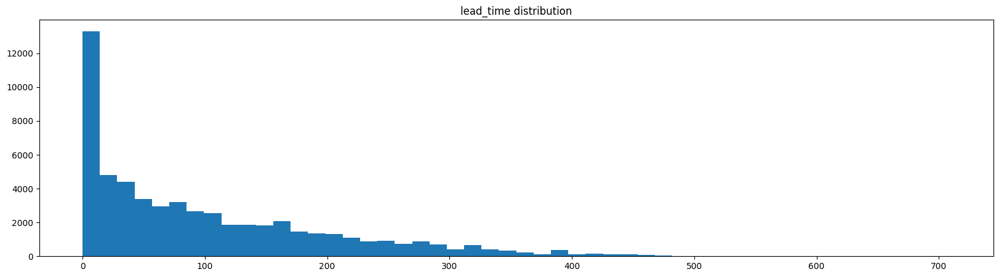

In [ ]:
plt.figure(figsize=(20, 5))
plt.hist(df[["lead_time"]], bins=50)
plt.title("lead_time distribution")
plt.plot()

En la gráfica anterior, podemos ver que sigue el comportamiento de una distribución exponencial los valores de anticipación de la reserva, lo cual corresponde al negocio, dado que es más normal reservar con poco tiempo el hotel.

### 1.2.6 arrival_date_month

In [ ]:
conteo = df["arrival_date_month"].value_counts()
conteo

,count
arrival_date_month,
August,7554
September,6583
July,6032
October,5904
May,5176
April,5090
June,4656
March,4393
February,3740


In [ ]:
df["arrival_date_month"].info()

<class 'pandas.core.series.Series'>
Index: 57575 entries, 2 to 58894
Series name: arrival_date_month
Non-Null Count  Dtype 
--------------  ----- 
57575 non-null  object
dtypes: object(1)
memory usage: 899.6+ KB


In [ ]:
df[df["arrival_date_day_of_month"].isnull() == True]

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,kids,sum_total_personas


No hay valores nulos

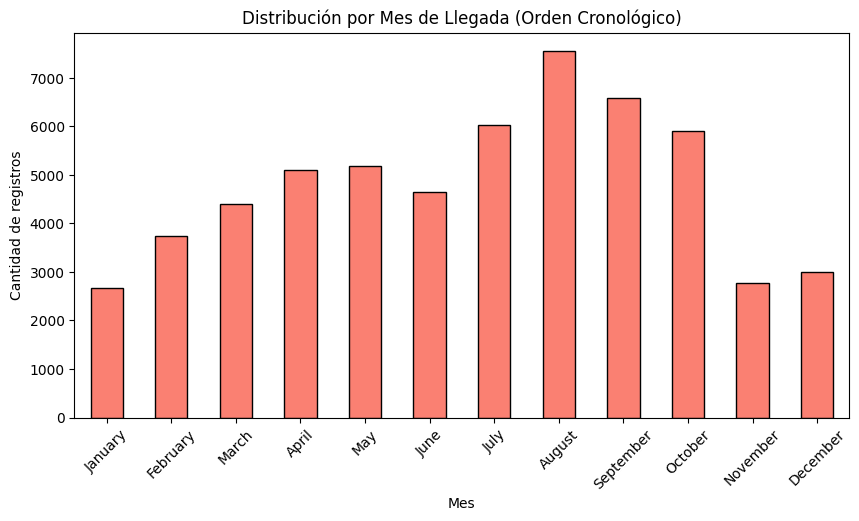

In [ ]:
import calendar
month_order = list(calendar.month_name)[1:]  # ['January', 'February', ..., 'December']

# Reordenar según calendario
counts = df["arrival_date_month"].value_counts().reindex(month_order)

# Gráfico
plt.figure(figsize=(10, 5))
counts.plot(kind="bar", color="salmon", edgecolor="black")
plt.title("Distribución por Mes de Llegada (Orden Cronológico)")
plt.xlabel("Mes")
plt.ylabel("Cantidad de registros")
plt.xticks(rotation=45)
plt.show()

De la distribución de la cantidad de reservas por meses, podemos ver que la mayoría están en los meses cercanos al verano (Julio, Agosto y Septiembre).

Las variables seleccionadas fueron:

- arrival_date_month: Mes de reserva

- deposit_type: Consideramos importante revisar el tipo de depósito, ya que esto puede influír en si las personas efectivamente asisten al hotel o cancelan.

- adr: Al definirse como Average Daily Rate. Que es la suma total del precio las transacciones realizadas por el grupo de personas sobre la cantidad de días, podemos hacer un análisis de quienes son los que más están gastando en los hoteles.

- is_canceled: Nos ayuda a revisar si la reserva fue cancelada o no

- lead_time: Con esto podemos ver si el tiempo de anticipación de la reserva afecta a la cancelación de esta o cantidad de dinero gastado de las personas

# 2. Descripción de estrategia

Inicialmente, revisaremos la correlación entre las variables escogidas y si se evidencia alguna tendencia entre ellas. El análisis partirá de la hipótesis de relaciones bivariadas hasta multivariadas.

Queremos responder las preguntas:



# 3. Desarrollo de la estrategia

## 3.1 ¿En qué meses se gasta más dinero las personas en las reservas?

In [ ]:
df_analisis=df[["adr","lead_time", "is_canceled", "arrival_date_month", "deposit_type"]]

In [ ]:
monthly_adr_mean= df_analisis.groupby("arrival_date_month")["adr"].mean().reset_index()
monthly_adr_mean["arrival_date_month"] = pd.Categorical(
    monthly_adr_mean["arrival_date_month"], categories=month_order, ordered=True
)

monthly_adr_mean = monthly_adr_mean.sort_values("arrival_date_month")
monthly_adr_mean

,arrival_date_month,adr
4,January,57.059318
3,February,60.162583
7,March,67.981452
0,April,84.943065
8,May,89.051399
6,June,111.757343
5,July,141.853815
1,August,156.324265
11,September,102.311325
10,October,78.279629


In [ ]:
#Con esta función testearemos normalidad en las variables para luego poder elegir pruebas de correlación.
from scipy.stats import shapiro
def es_normal(columna):
    stat, p = shapiro(columna)
    print(f"Estadístico={stat:.3f}, p={p:.3f}")
    if p > 0.05:
        print("No se rechaza H0: la variable parece normal")
    else:
        print("Se rechaza H0: la variable NO es normal")

In [ ]:
for i in df_analisis[["adr","lead_time", "is_canceled"]]:
  print(i)
  es_normal(df_analisis[i])

adr
Estadístico=0.900, p=0.000
Se rechaza H0: la variable NO es normal
lead_time
Estadístico=0.869, p=0.000
Se rechaza H0: la variable NO es normal
is_canceled
Estadístico=0.626, p=0.000
Se rechaza H0: la variable NO es normal


/usr/local/lib/python3.12/dist-packages/scipy/stats/_axis_nan_policy.py:586: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 57575.
  res = hypotest_fun_out(*samples, **kwds)


Como evidenciamos, ya ninguna de las 3 variables numéricas escogidas es normal, por lo tanto usar coeficiente de pearson para realizar pruebas de correlación no es posible. Se opta por Spearman.

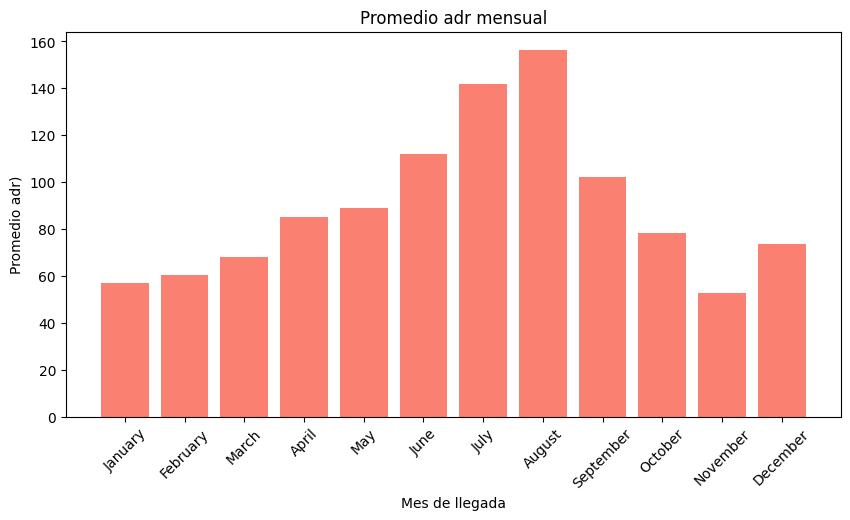

In [ ]:
plt.figure(figsize=(10, 5))
plt.bar(monthly_adr_mean["arrival_date_month"], monthly_adr_mean["adr"], color="salmon")
plt.title("Promedio adr mensual")
plt.xlabel("Mes de llegada")
plt.ylabel("Promedio adr)")
plt.xticks(rotation=45)
plt.show()

## 3.2 ¿Cuáles son los meses con mayor porcentaje de cancelación?

In [ ]:
# Agrupar por mes y calcular total y cancelaciones
resumen = df_analisis.groupby("arrival_date_month").agg(
    total_reservas=("is_canceled", "count"),
    total_canceladas=("is_canceled", "sum")
).reset_index()

# Calcular porcentaje
resumen["porcentaje_cancelaciones"] = (
    resumen["total_canceladas"] / resumen["total_reservas"] * 100
)
print(resumen)

   arrival_date_month  total_reservas  total_canceladas  \
0               April            5090              2386   
1              August            7554              3272   
2            December            2996               834   
3            February            3740              1343   
4             January            2670               574   
5                July            6032              2677   
6                June            4656              2594   
7               March            4393              1668   
8                 May            5176              2358   
9            November            2781               586   
10            October            5904              2540   
11          September            6583              3101   

    porcentaje_cancelaciones  
0                  46.876228  
1                  43.314800  
2                  27.837116  
3                  35.909091  
4                  21.498127  
5                  44.379973  
6              

In [ ]:
month_order = list(calendar.month_name)[1:]  # ['January', ..., 'December']

resumen["arrival_date_month"] = pd.Categorical(
    resumen["arrival_date_month"], categories=month_order, ordered=True
)

resumen = resumen.sort_values("arrival_date_month")

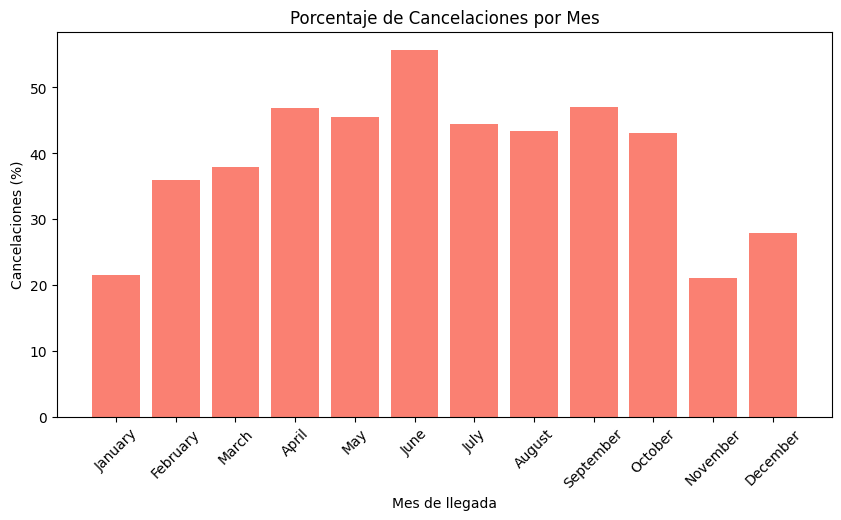

In [ ]:
plt.figure(figsize=(10, 5))
plt.bar(resumen["arrival_date_month"], resumen["porcentaje_cancelaciones"], color="salmon")
plt.title("Porcentaje de Cancelaciones por Mes")
plt.xlabel("Mes de llegada")
plt.ylabel("Cancelaciones (%)")
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Cancelaciones por mes
cancelaciones = df_analisis.groupby("arrival_date_month").agg(
    total_reservas=("is_canceled", "count"),
    total_canceladas=("is_canceled", "sum")
).reset_index()

cancelaciones["porcentaje_cancelaciones"] = (
    cancelaciones["total_canceladas"] / cancelaciones["total_reservas"] * 100
)

# ADR promedio por mes
adr_mensual = df_analisis.groupby("arrival_date_month").agg(
    promedio_adr=("adr", "mean")
).reset_index()

# Unir en un solo dataframe
resumen = pd.merge(cancelaciones[["arrival_date_month", "porcentaje_cancelaciones"]],
                   adr_mensual,
                   on="arrival_date_month")

In [ ]:

month_order = list(calendar.month_name)[1:]  # ['January', ..., 'December']

resumen["arrival_date_month"] = pd.Categorical(
    resumen["arrival_date_month"], categories=month_order, ordered=True
)

resumen = resumen.sort_values("arrival_date_month")

In [ ]:
from scipy.stats import pearsonr, spearmanr

# Extraer las dos series numéricas
x = resumen["porcentaje_cancelaciones"]
y = resumen["promedio_adr"]

# Correlación de Spearman
spearman_corr, spearman_p = spearmanr(x, y)

print(f"Spearman: correlación={spearman_corr:.3f}, p-valor={spearman_p:.3f}")

Spearman: correlación=0.797, p-valor=0.002


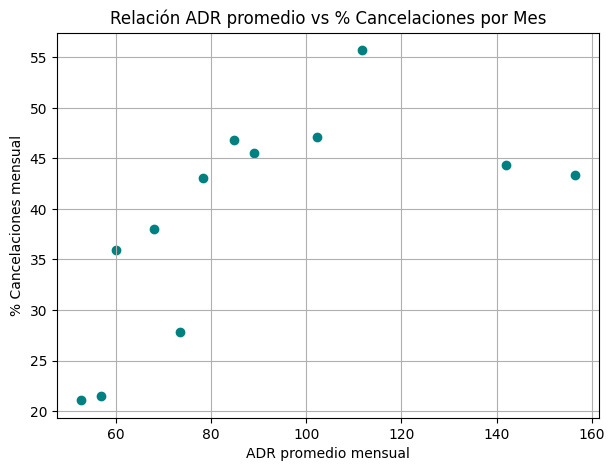

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(7,5))
plt.scatter(resumen["promedio_adr"], resumen["porcentaje_cancelaciones"], color="teal")
plt.title("Relación ADR promedio vs % Cancelaciones por Mes")
plt.xlabel("ADR promedio mensual")
plt.ylabel("% Cancelaciones mensual")
plt.grid(True)
plt.show()

## 3.3 ¿El tipo de reserva afecta las cancelaciones?

In [ ]:
df_pie=(df_analisis.groupby("deposit_type")["is_canceled"].sum()/len(df_analisis[df["is_canceled"]==1])).reset_index()
df_pie

,deposit_type,is_canceled
0,No Deposit,0.735303
1,Non Refund,0.263778
2,Refundable,0.000919


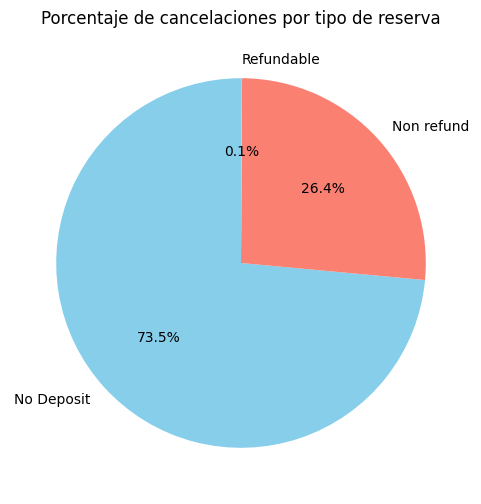

In [ ]:
counts = df_pie["is_canceled"]

labels = ["No Deposit", "Non refund", "Refundable"]
plt.figure(figsize=(6, 6))
plt.pie(counts, labels=labels, autopct="%1.1f%%", startangle=90, colors=["skyblue", "salmon", "lightgreen"])
plt.title("Porcentaje de cancelaciones por tipo de reserva")
plt.show()

## 3.4 ¿El tiempo de anticipación de la reserva puede ayudar a predecir si se va a cancelar o no?

In [ ]:
cancelaciones_lead= df_analisis.groupby("lead_time")["is_canceled"].sum().reset_index()
cancelaciones_lead

,lead_time,is_canceled
0,0,277
1,1,236
2,2,149
3,3,118
4,4,118
...,...,...
421,471,6
422,532,0
423,542,0
424,605,8


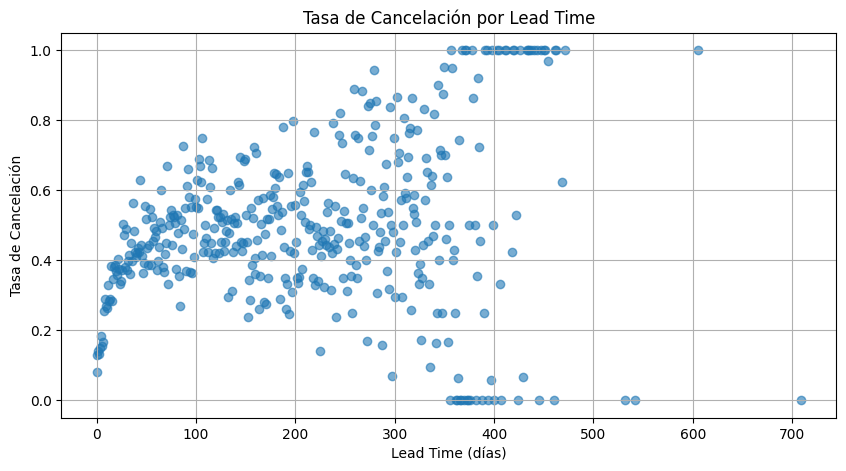

In [ ]:
# Calculamos la tasa de cancelación
tasa_cancelacion = (
    df_analisis.groupby("lead_time")["is_canceled"]
    .mean()  # promedio = proporción de cancelaciones
)

# Graficamos
plt.figure(figsize=(10,5))
plt.scatter(tasa_cancelacion.index, tasa_cancelacion.values, alpha=0.6)

plt.title("Tasa de Cancelación por Lead Time")
plt.xlabel("Lead Time (días)")
plt.ylabel("Tasa de Cancelación")
plt.grid(True)
plt.show()

In [ ]:
# Extraer las dos series numéricas
x = cancelaciones_lead["lead_time"]
y = cancelaciones_lead["is_canceled"]

# Correlación de Spearman
spearman_corr, spearman_p = spearmanr(x, y)

print(f"Spearman: correlación={spearman_corr:.3f}, p-valor={spearman_p:.3f}")

Spearman: correlación=-0.829, p-valor=0.000


/tmp/ipython-input-555357298.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_analisis["lead_time_bin"] = pd.cut(
/tmp/ipython-input-555357298.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_analisis.groupby("lead_time_bin")["is_canceled"]


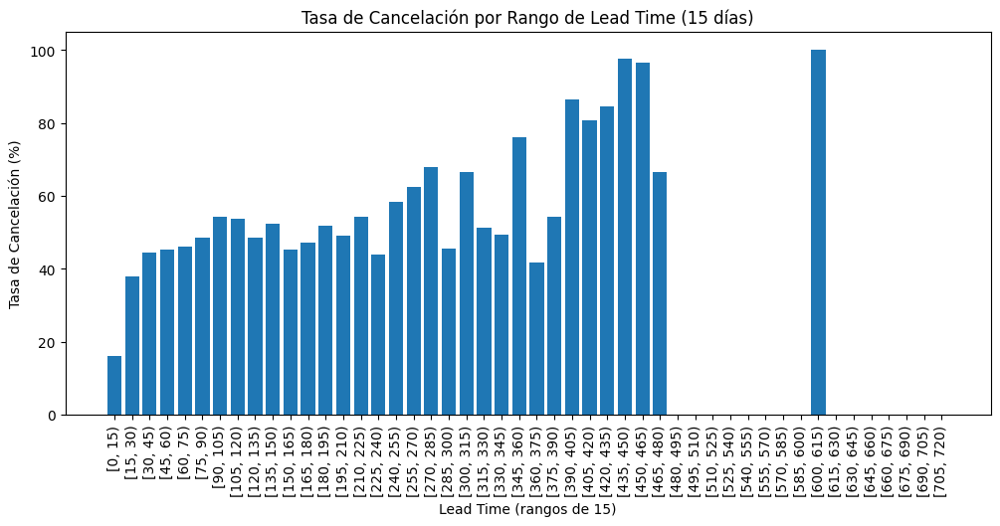

In [ ]:
# Crear los bins (rangos de 20 en 20)
df_analisis["lead_time_bin"] = pd.cut(
    df_analisis["lead_time"],
    bins=range(0, df_analisis["lead_time"].max() + 15, 15),
    right=False
)

# Calcular la tasa de cancelación por rango
tasa_cancelacion_lead = (
    df_analisis.groupby("lead_time_bin")["is_canceled"]
    .mean()
    .reset_index()
)

# Gráfico de barras
plt.figure(figsize=(12,5))
plt.bar(tasa_cancelacion_lead["lead_time_bin"].astype(str),
        tasa_cancelacion_lead["is_canceled"]*100)

plt.title("Tasa de Cancelación por Rango de Lead Time (15 días)")
plt.xlabel("Lead Time (rangos de 15)")
plt.ylabel("Tasa de Cancelación (%)")
plt.xticks(rotation=90)
plt.show()

Como evidenciamos que la data se agrupa entre 0 y 500, el dato del rango de 600 lo tomaremos como un dato atípico, y por lo tanto, para realizar una prueba de correlación no lo tendremos en cuenta.

In [ ]:
tasa_cancelacion_lead[:32]

,lead_time_bin,is_canceled,lead_time_bin_code
0,"[0, 15)",0.161571,0
1,"[15, 30)",0.378458,1
2,"[30, 45)",0.446088,2
3,"[45, 60)",0.454168,3
4,"[60, 75)",0.461473,4
5,"[75, 90)",0.486776,5
6,"[90, 105)",0.541840,6
7,"[105, 120)",0.537418,7
8,"[120, 135)",0.484681,8
9,"[135, 150)",0.525105,9


In [ ]:
# Convertir los rangos (categoría) en códigos ordinales
tasa_cancelacion_lead["is_canceled"]=tasa_cancelacion_lead["is_canceled"].fillna(0)
tasa_cancelacion_lead["lead_time_bin_code"] = tasa_cancelacion_lead["lead_time_bin"].cat.codes

# Calcular Spearman
rho, p_valor = spearmanr(tasa_cancelacion_lead["lead_time_bin_code"][:32], tasa_cancelacion_lead["is_canceled"][:32])

print(f"Coeficiente de Spearman: {rho:.3f}")


Coeficiente de Spearman: 0.708


Como el coeficiente de Spearman es positivo y de 0.7, encontramos una correlación monota positiva y fuerte entre estas dos variables.

<Axes: xlabel='lead_time_bin'>

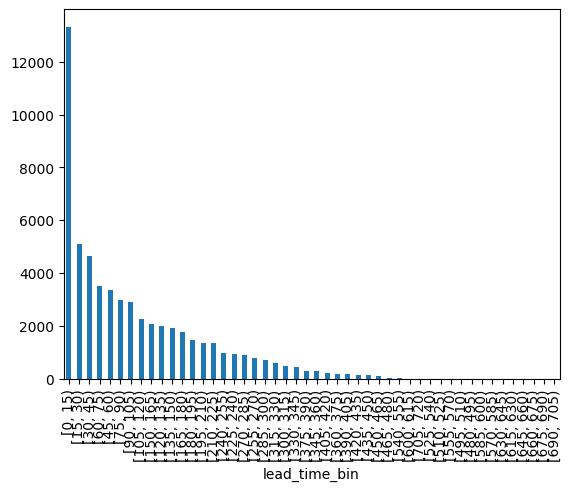

In [ ]:
df_analisis["lead_time_bin"].value_counts().plot(kind="bar")

## 3.5 ¿El tiempo de anticipación afecta la cantidad de dinero gastado por las personas?

In [ ]:
adr_lead= df_analisis.groupby("lead_time")["adr"].mean().reset_index()

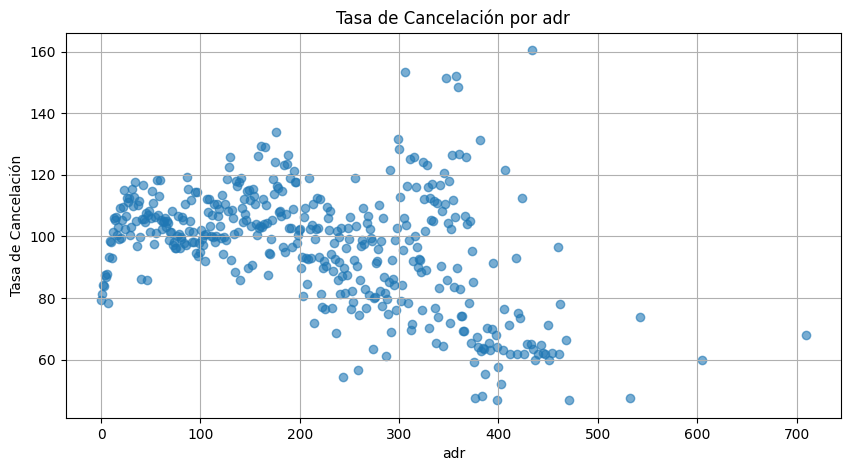

In [ ]:
tasa_cancelacion = (
    df_analisis.groupby("lead_time")["adr"]
    .mean()
)
# Graficamos
plt.figure(figsize=(10,5))
plt.scatter(tasa_cancelacion.index, tasa_cancelacion.values, alpha=0.6)

plt.title("Tasa de Cancelación por adr")
plt.xlabel("adr")
plt.ylabel("Tasa de Cancelación")
plt.grid(True)
plt.show()

In [ ]:
# Extraer las dos series numéricas
x = adr_lead["lead_time"]
y = adr_lead["adr"]

# Correlación de Spearman
spearman_corr, spearman_p = spearmanr(x, y)

print(f"Spearman: correlación={spearman_corr:.3f}, p-valor={spearman_p:.3f}")

Spearman: correlación=-0.392, p-valor=0.000


In [ ]:
import statsmodels.api as sm

# Variables independientes
X = df_analisis[[ "adr", "lead_time"]]


X = X.astype(float)

# Variable dependiente
y = df_analisis["is_canceled"]

# Agregar intercepto
X = sm.add_constant(X)


In [ ]:
modelo = sm.Logit(y, X).fit()
print(modelo.summary())

Optimization terminated successfully.
         Current function value: 0.640559
         Iterations 5
                           Logit Regression Results                           
Dep. Variable:            is_canceled   No. Observations:                57575
Model:                          Logit   Df Residuals:                    57572
Method:                           MLE   Df Model:                            2
Date:                Mon, 22 Sep 2025   Pseudo R-squ.:                 0.05642
Time:                        03:47:14   Log-Likelihood:                -36880.
converged:                       True   LL-Null:                       -39085.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -1.3877      0.021    -64.649      0.000      -1.430      -1.346
adr            0.0052      0.

In [ ]:
coeficientes = modelo.params
print(coeficientes)

const       -1.387721
adr          0.005216
lead_time    0.005148
dtype: float64
